In [6]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from datetime import datetime, timedelta
from sklearn.neighbors import KernelDensity
import calendar
import time

In [7]:
#importing spray and train data
spray=pd.read_csv('../data/spray.csv')
train=pd.read_csv('../data/weather_train_merged.csv')

In [8]:
spray.Date = pd.to_datetime(spray.Date)
train.Date = pd.to_datetime(train.Date)
spray.set_index(spray['Date'],inplace=True)
train.set_index(train['Date'],inplace=True)
train.drop(columns='Date',inplace=True)
train.rename(columns={'year_y':'year','week_y':'week'},inplace=True)
#organising into 2011 and 2013
spray['year'] = spray['Date'].dt.year
spray['month']= spray.index.strftime('%b')
spray['week']=spray.index.strftime('%V').astype(int)
spray_2011 = spray[spray['year'] == 2011]
spray_2013 = spray[spray['year'] == 2013]


# PLOTTING MAPS

# 2013 WNV PRESENCE OVER MONTH

In [13]:
def over_month(train,spray,year,col):
    mapdata = np.loadtxt("../data/mapdata_copyright_openstreetmap_contributors.txt")

    aspect = mapdata.shape[0] * 1.0 / mapdata.shape[1]
    lon_lat_box = (-88, -87.5, 41.6, 42.1)
    for i in train.loc[train.year==year]['month'].unique():
        plt.figure(figsize=(10,14))
        plt.imshow(mapdata, cmap=plt.get_cmap('gray'), extent=lon_lat_box, aspect=aspect)

        #plotting for all sprays
        spray_plot = spray.drop_duplicates()
        spray_plot = spray_plot.loc[spray_plot['month']==i]
        plt.scatter(spray_plot['Longitude'], spray_plot['Latitude'], marker='x', color='blue',alpha=.05, label='Spray Locations')
        
        #plotting for all the traps
        locations = train[['Longitude', 'Latitude']].drop_duplicates().values
        plt.scatter(locations[:,0], locations[:,1], marker='o', label='Trap Locations',color = 'yellow')
        #plotting for stations
        plt.scatter(x = (-87.933, -87.752), y = (41.995, 41.786), marker='v', color='green', label='Weather Station')

        #import colour map
        alpha_cm = plt.cm.Reds
        alpha_cm._init()
        alpha_cm._lut[:-3,-1] = abs(np.logspace(0, 1, alpha_cm.N) / 10 - 1)[::-1]
        aspect = mapdata.shape[0] * 1.0 / mapdata.shape[1]

        #Traps where only WNV is present
        sightings = train.loc[(train[col] == 1) & (train['year'] == year) & (train['month']==i)]
        sightings = sightings.groupby(['Date', 'Trap','Longitude', 'Latitude']).max()[col].reset_index()
        X = sightings[['Longitude', 'Latitude']].values
        kd = KernelDensity(bandwidth=0.01)
        kd.fit(X)

        #creating meshgrid to plot the density of virus presence near a trap
        xv,yv = np.meshgrid(np.linspace(-88, -87.5, 100), np.linspace(41.6, 42.1, 100))
        gridpoints = np.array([xv.ravel(),yv.ravel()]).T
        zv = np.exp(kd.score_samples(gridpoints).reshape(100,100))
        plt.imshow(zv, origin='lower', cmap=alpha_cm, extent=lon_lat_box, aspect=aspect)

        plt.title('WNV Presence for {} {}'.format(i,year))
        plt.legend(frameon=1)
        plt.xlabel('Longitude')
        plt.ylabel('Latitude')
        plt.savefig('../image/WNVpresent{}{}.png'.format(i,year))

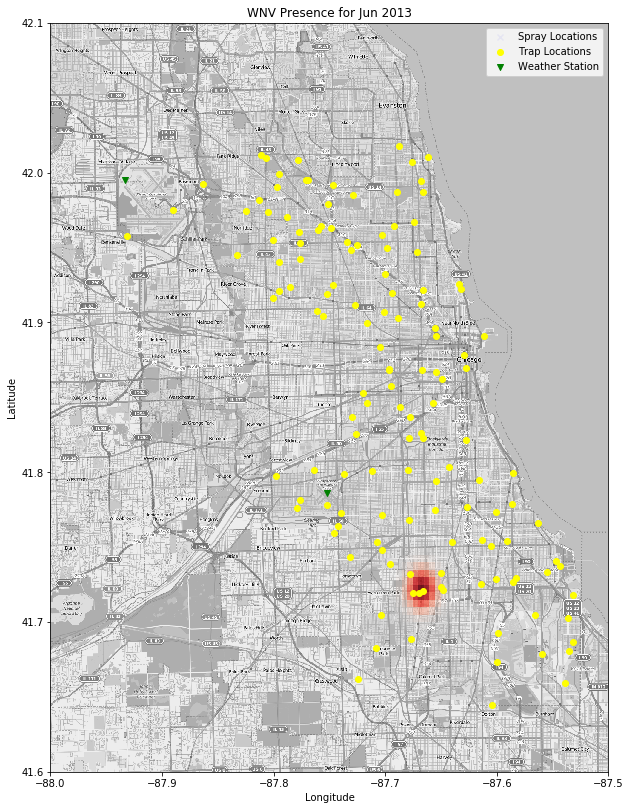

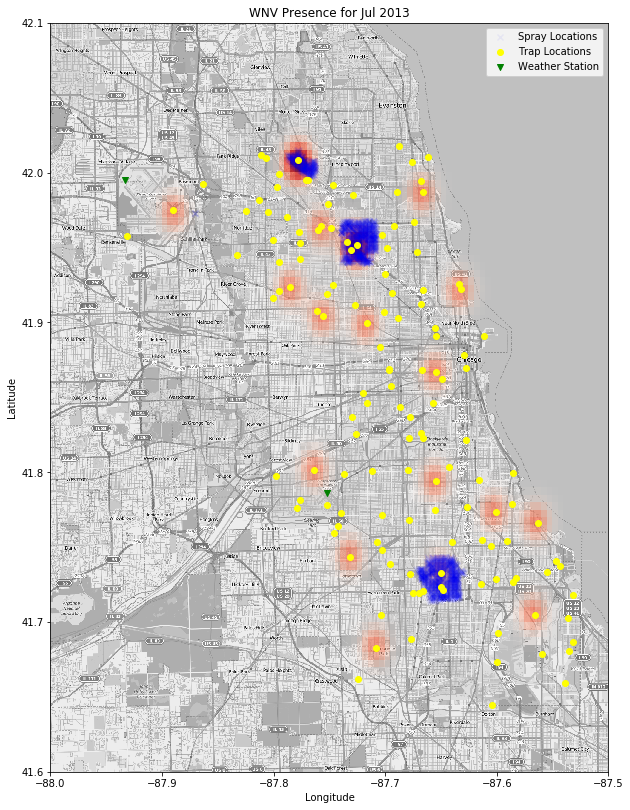

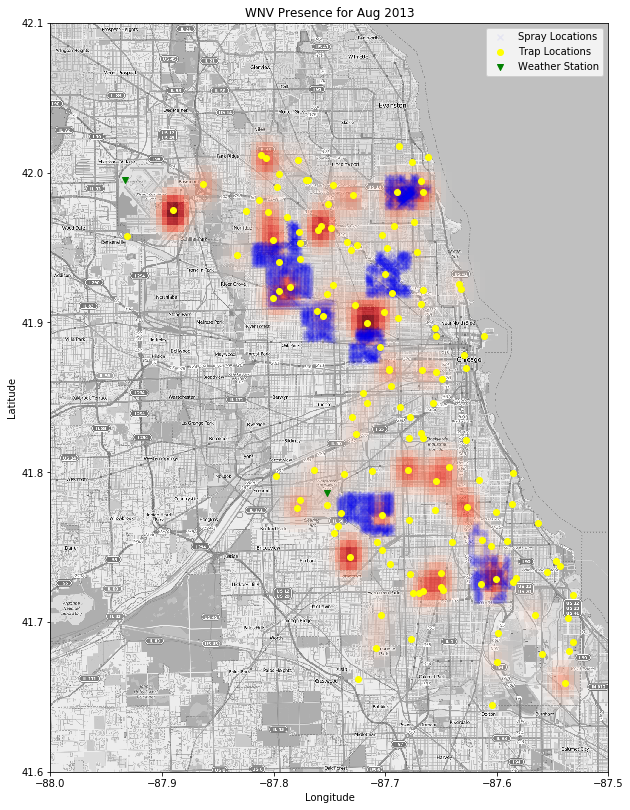

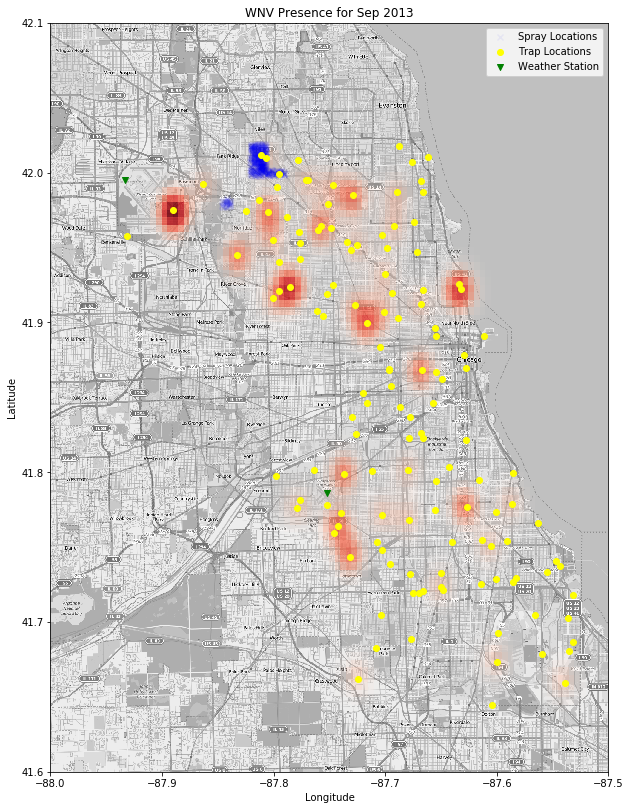

In [14]:
over_month(train=train,spray=spray_2013,year=2013,col='WnvPresent')


# 2013 WNV PRESENCE OVER WEEK

In [15]:
def over_week(train,spray,year,col):
    mapdata = np.loadtxt("../data/mapdata_copyright_openstreetmap_contributors.txt")

    aspect = mapdata.shape[0] * 1.0 / mapdata.shape[1]
    lon_lat_box = (-88, -87.5, 41.6, 42.1)
    for i in train.loc[(train.year==year)&(train[col]==1)]['week'].unique():
        plt.figure(figsize=(10,14))
        plt.imshow(mapdata, cmap=plt.get_cmap('gray'), extent=lon_lat_box, aspect=aspect)

        #plotting for all sprays
        spray_plot = spray.drop_duplicates()
        spray_plot = spray_plot.loc[spray_plot['week']==i]
        plt.scatter(spray_plot['Longitude'], spray_plot['Latitude'], marker='x', color='blue',alpha=.05, label='Spray Locations')
        
        #plotting for all the traps
        locations = train[['Longitude', 'Latitude']].drop_duplicates().values
        plt.scatter(locations[:,0], locations[:,1], marker='o', label='Trap Locations',color = 'yellow')
        #plotting for stations
        plt.scatter(x = (-87.933, -87.752), y = (41.995, 41.786), marker='v', color='green', label='Weather Station')

        #import colour map
        alpha_cm = plt.cm.Reds
        alpha_cm._init()
        alpha_cm._lut[:-3,-1] = abs(np.logspace(0, 1, alpha_cm.N) / 10 - 1)[::-1]
        aspect = mapdata.shape[0] * 1.0 / mapdata.shape[1]

        #Traps where only WNV is present
        sightings = train.loc[(train[col] == 1) & (train['year'] == year) & (train['week']==i)]
        sightings = sightings.groupby(['Date', 'Trap','Longitude', 'Latitude']).max()[col].reset_index()
        X = sightings[['Longitude', 'Latitude']].values
        kd = KernelDensity(bandwidth=0.01)
        kd.fit(X)

        #creating meshgrid to plot the density of virus presence near a trap
        xv,yv = np.meshgrid(np.linspace(-88, -87.5, 100), np.linspace(41.6, 42.1, 100))
        gridpoints = np.array([xv.ravel(),yv.ravel()]).T
        zv = np.exp(kd.score_samples(gridpoints).reshape(100,100))
        plt.imshow(zv, origin='lower', cmap=alpha_cm, extent=lon_lat_box, aspect=aspect)

        plt.title('WNV Presence for Week {} {}'.format(i,year))
        plt.legend(frameon=1)
        plt.xlabel('Longitude')
        plt.ylabel('Latitude')
        plt.savefig('../image/{}WNVpresent{}.png'.format(year,i))

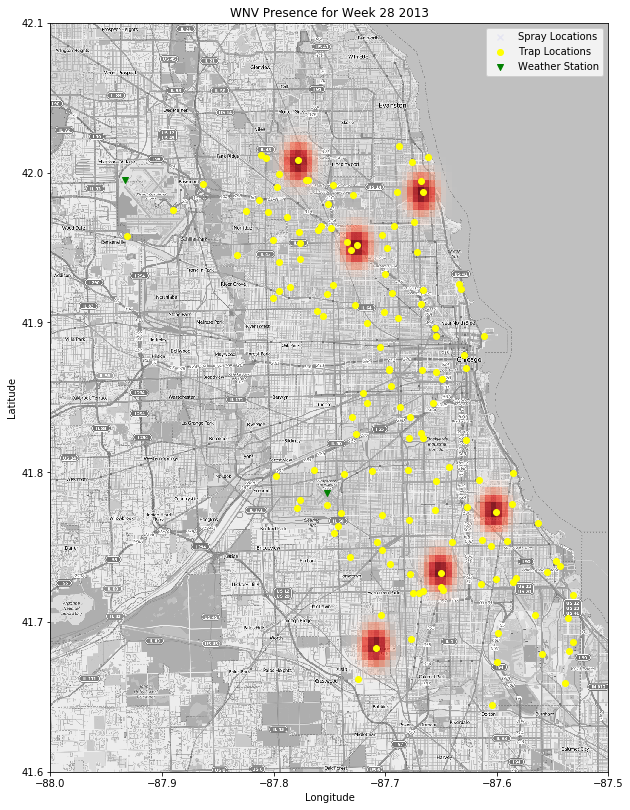

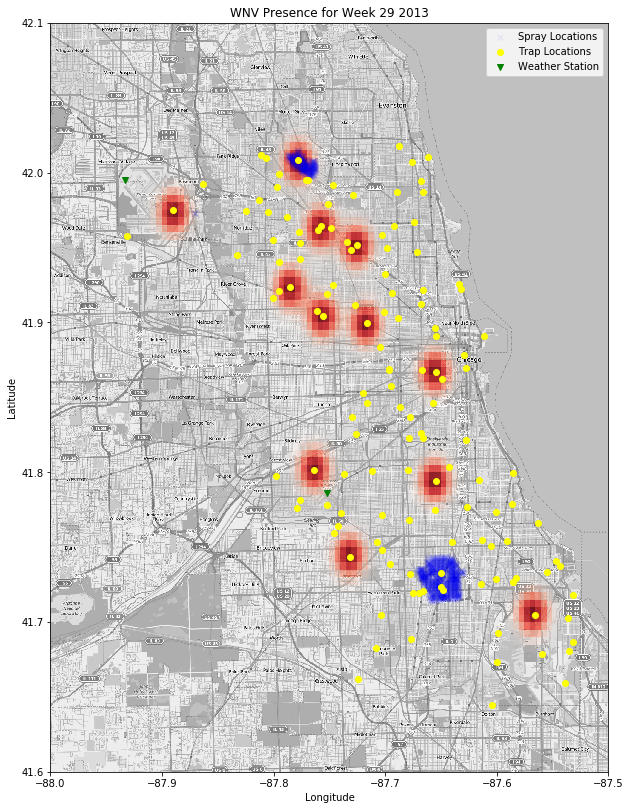

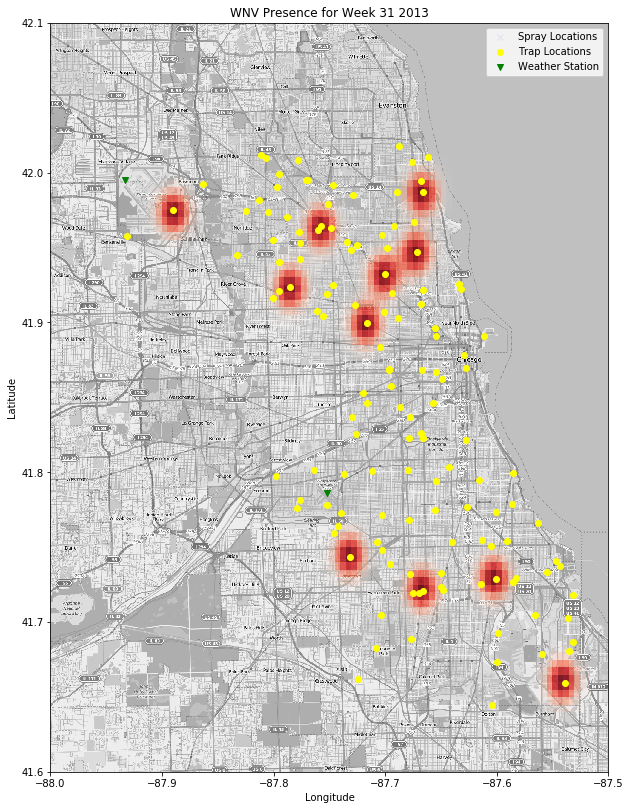

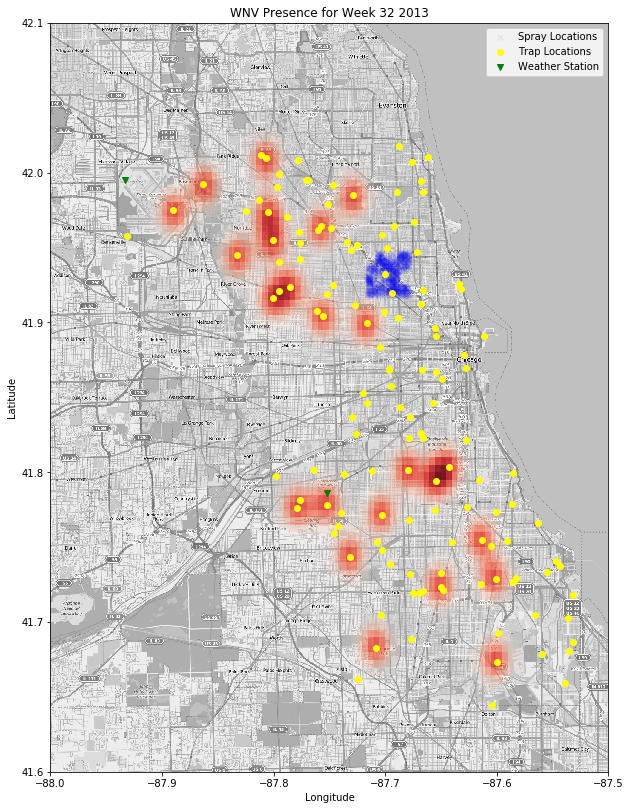

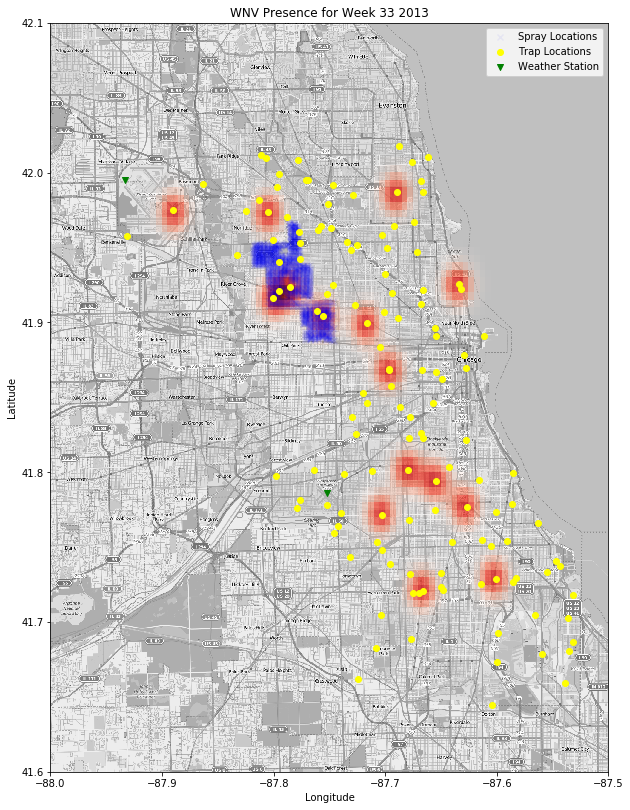

...

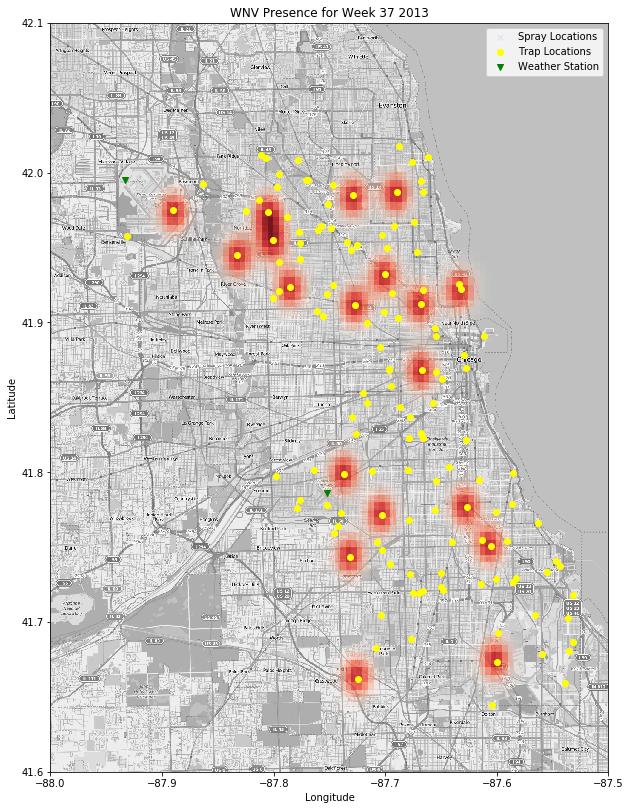

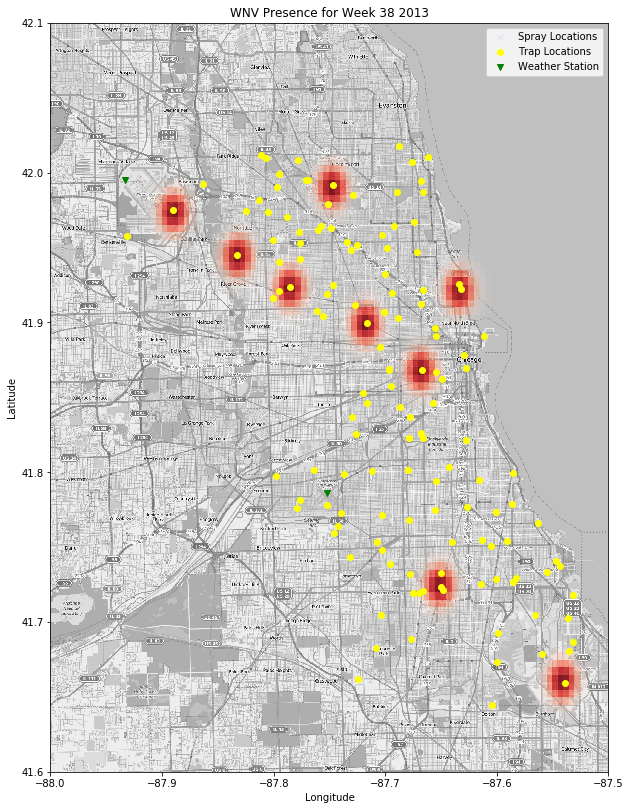

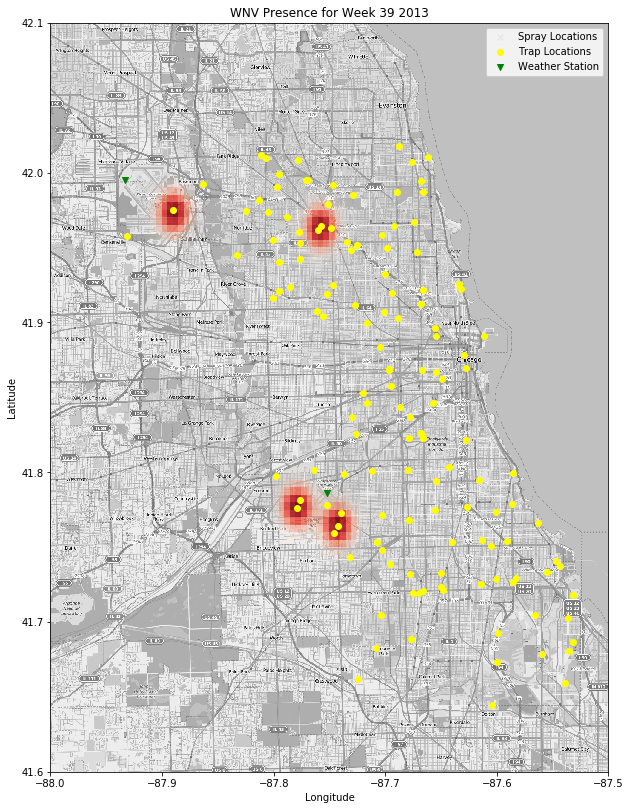

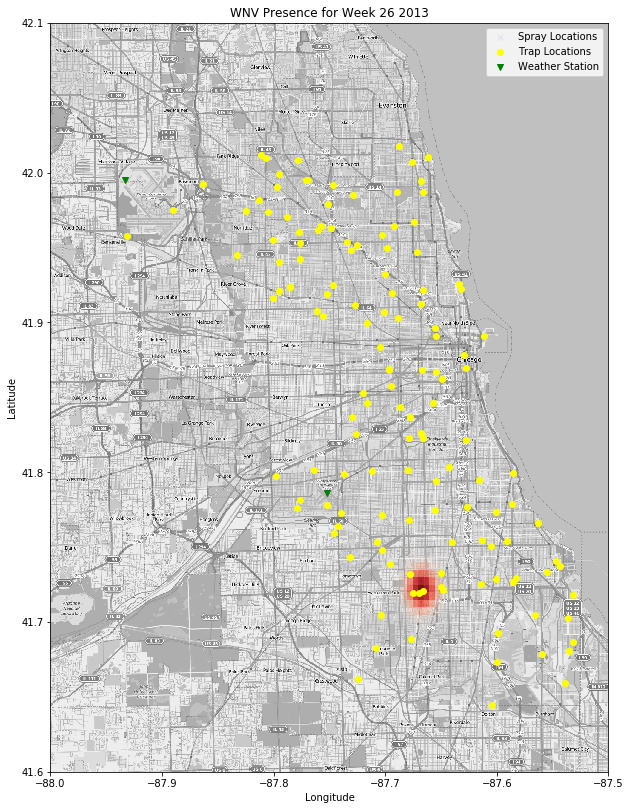

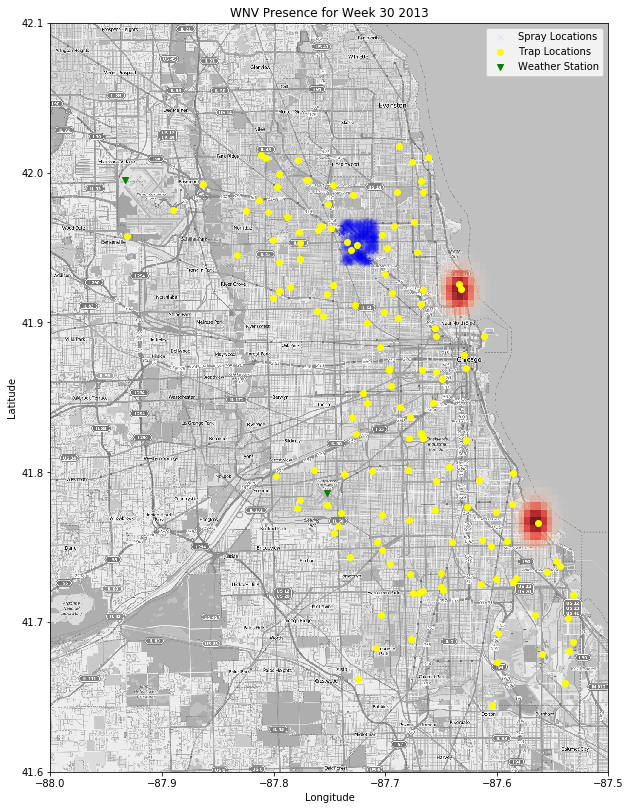

In [16]:
over_week(train=train,spray=spray_2013,year=2013,col='WnvPresent')

# 2011 WNV PRESENCE OVER WEEK

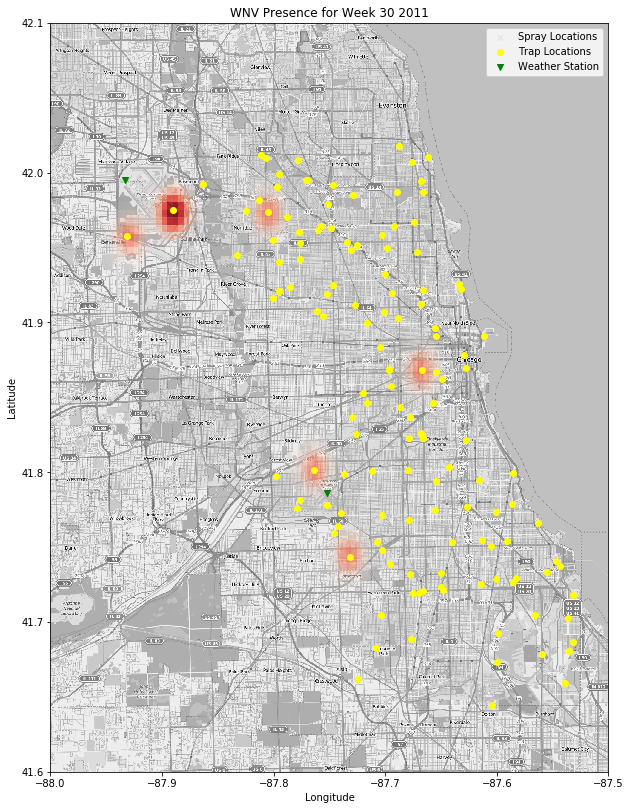

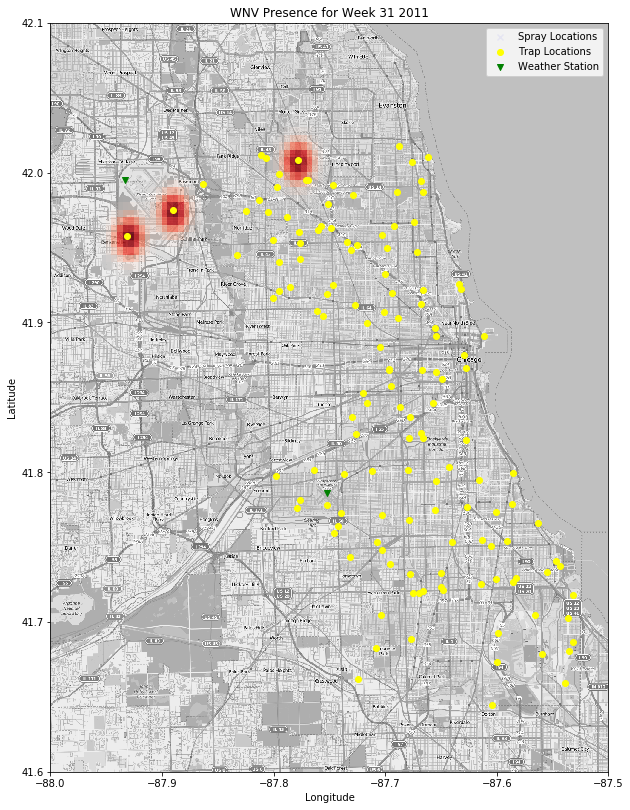

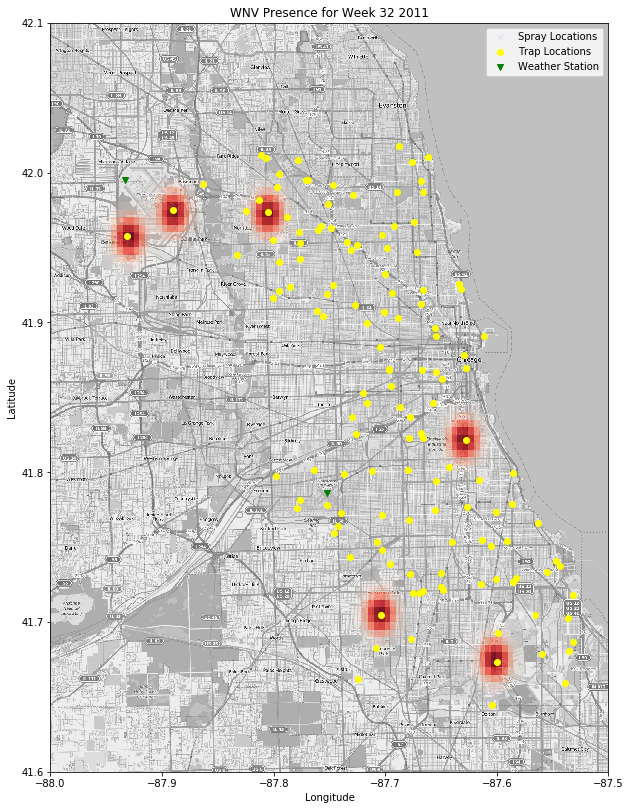

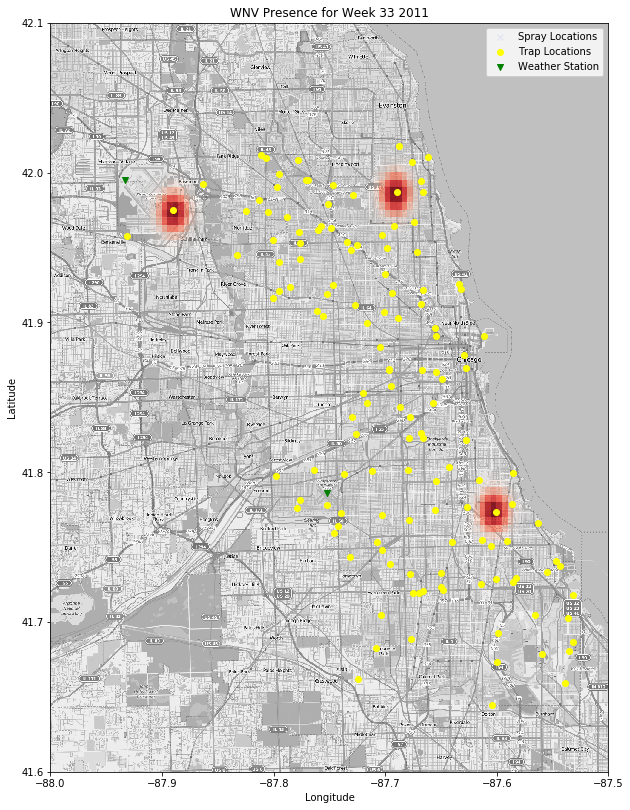

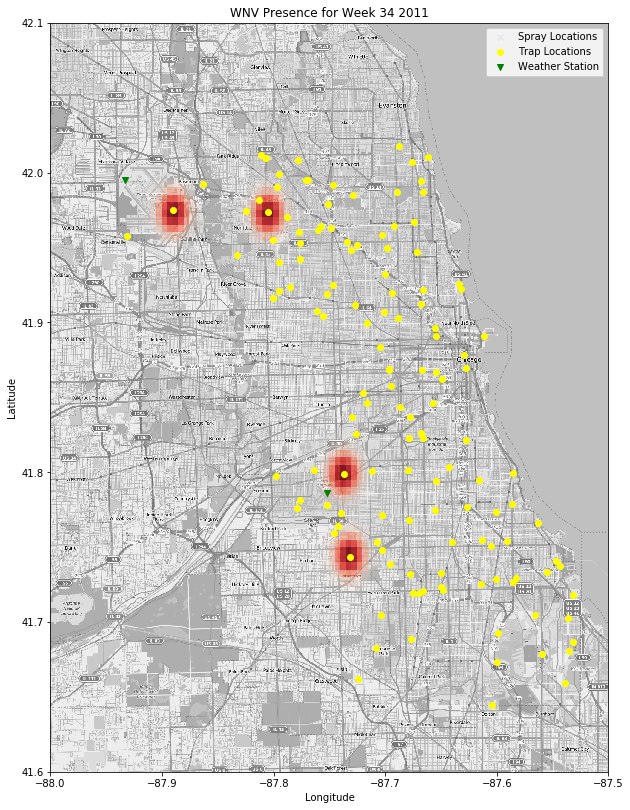

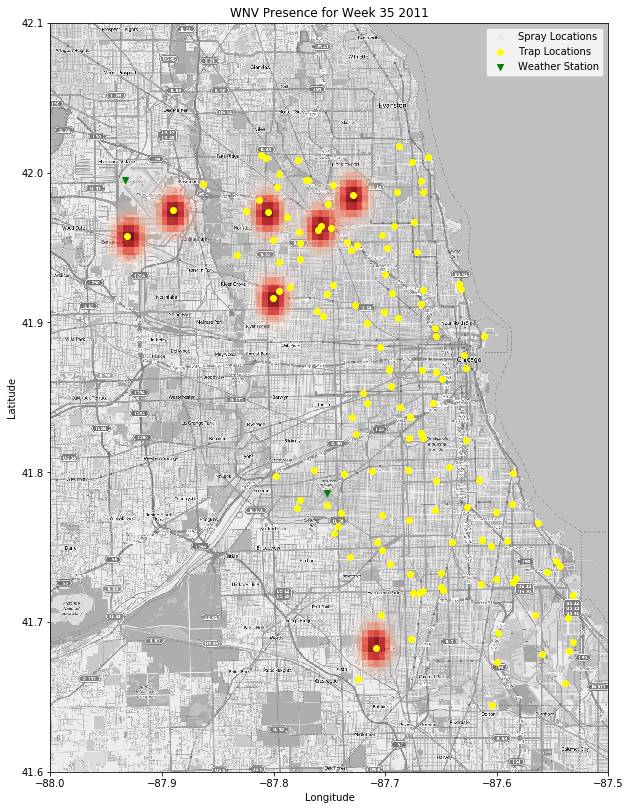

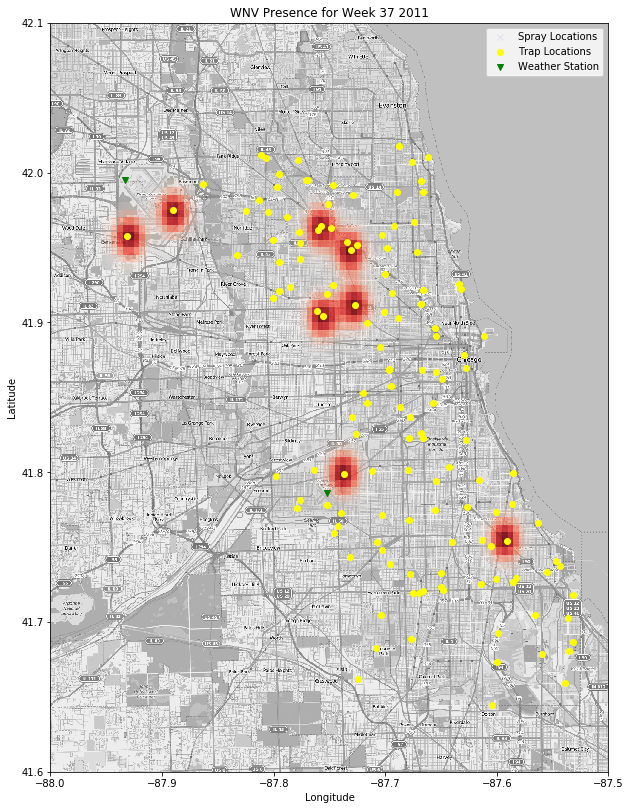

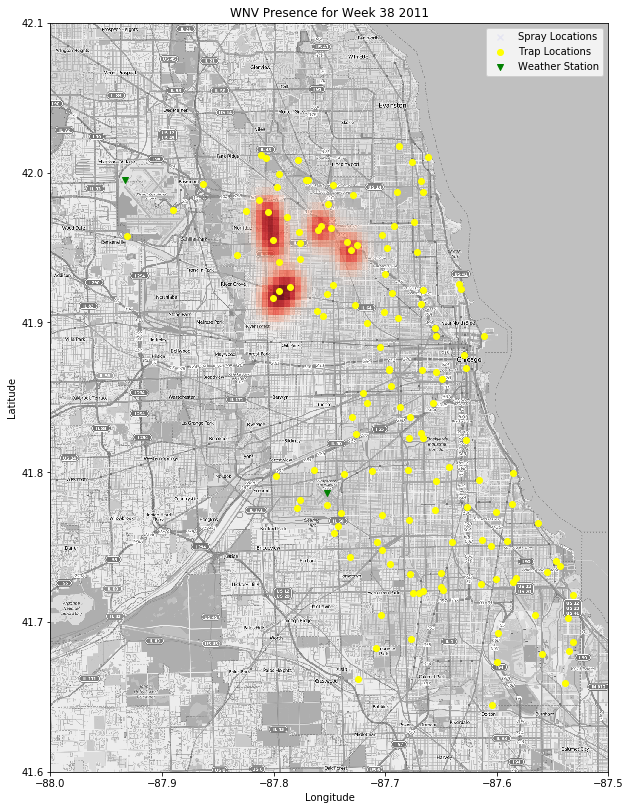

In [17]:
over_week(train=train,spray=spray_2011,year=2011,col='WnvPresent')

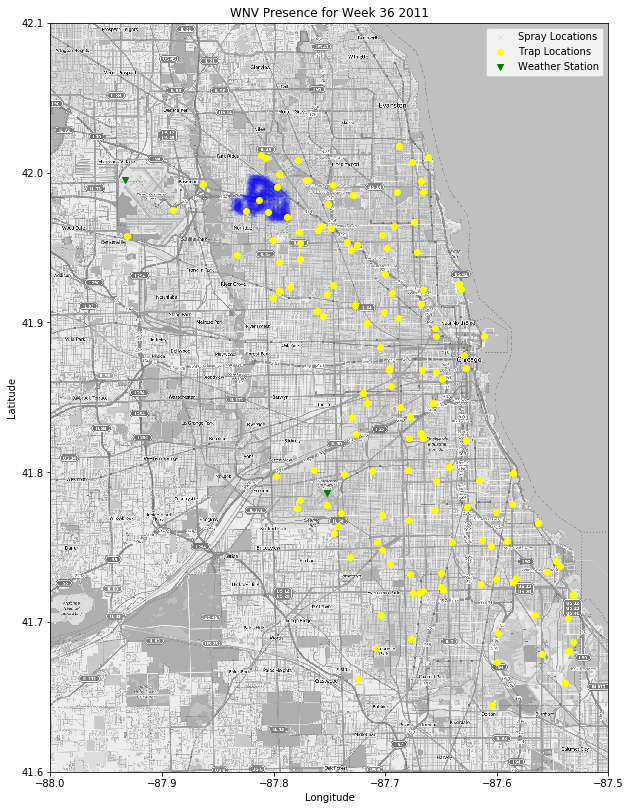

In [20]:
#creating spray map for week 35, 2011
mapdata = np.loadtxt("../data/mapdata_copyright_openstreetmap_contributors.txt")
aspect = mapdata.shape[0] * 1.0 / mapdata.shape[1]
lon_lat_box = (-88, -87.5, 41.6, 42.1)

plt.figure(figsize=(10,14))
plt.imshow(mapdata, cmap=plt.get_cmap('gray'), extent=lon_lat_box, aspect=aspect)

#plotting for all sprays
spray_plot = spray_2011.drop_duplicates()
spray_plot = spray_plot.loc[spray_plot['week']==36]
plt.scatter(spray_plot['Longitude'], spray_plot['Latitude'], marker='x', color='blue',alpha=.05, label='Spray Locations')
        
#plotting for all the traps
locations = train[['Longitude', 'Latitude']].drop_duplicates().values
plt.scatter(locations[:,0], locations[:,1], marker='o', label='Trap Locations',color = 'yellow')
#plotting for stations
plt.scatter(x = (-87.933, -87.752), y = (41.995, 41.786), marker='v', color='green', label='Weather Station')

plt.title('WNV Presence for Week {} {}'.format(36,2011))
plt.legend(frameon=1)
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.savefig('../image/{}WNVpresent{}.png'.format(2011,36))